**Новый эксперимент - модель YOLO v8 - для начала проверим ее на классификацию**

Загрузим библиотеки


In [ ]:

import zipfile
import os

import requests
import cv2
import matplotlib.pyplot as plt
import glob 
import random

import pickle

import pandas as pd
import numpy as np

# подключение гугл диска
from google.colab import drive
drive.mount('/content/drive')

# скрытие предупреждений
import warnings
warnings.filterwarnings("ignore")

# тут загрузим библиотеки для распознавания лиц

!pip install face_recognition
import face_recognition

from tqdm import tqdm
from PIL import Image, ImageDraw
from google.colab.patches import cv2_imshow
import pathlib
from pathlib import Path

!pip install ultralytics
from ultralytics import YOLO

import itertools
import math
import warnings
!pip install mediapy
import mediapy as media


Mounted at /content/drive
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.1/100.1 MB 8.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


**Загрузим изначальны датасет**

In [ ]:
# путь к тренировочному файлу
train_zip_file = '/content/drive/MyDrive/diplom/train.zip'
# распаковать файлы
train_files = zipfile.ZipFile(train_zip_file, 'r')
train_files.extractall()


Пытался обработать датасет для выделения параметров boundingbox - но это очень долго, пайплайн ниже

----------------------------------------------------


In [ ]:
df_image = dict()

rootDir = '/content/train'


idx = 0
for lists in os.listdir(rootDir): # перебирает папки с эмоциями

    path = os.path.join(rootDir, lists)

    
    
    for img_name in tqdm(os.listdir(path)): # перебирает имена файлов
        img_path = os.path.join(path, img_name) # объединяет имена файлов с путями
 
        image_fr = face_recognition.load_image_file(img_path)

        face_locations = face_recognition.face_locations(image_fr)

        # если faces = 1 все ок - сохраняем
        
        if len(face_locations) >=1: # первая проверка fr
          count = 0
          with Image.open(img_path) as img:
            # weight = os.path.getsize(img_path)
            width, heigth = img.size

          
          if len(face_locations) >=1: 
            for face_location in face_locations:
              top, right, bottom, left = face_location

                
              img_name_local = str('{}_{}_{}'.format(lists, count, img_name))
              df_image[idx] = {'path': img_path, 
                                'new_img_name':img_name_local, 
                                'emotion': lists,

                                'width': width,
                                'heigth': heigth,
                                'top': top,
                                'right': right,
                                'bottom': bottom,
                                'left': left}

              idx += 1  
              count += 1
          # if (idx+1)%10 == 0:
          #   break
              
        

  5%|▌         | 336/6323 [02:21<41:57,  2.38it/s]


KeyboardInterrupt: ignored

In [ ]:
df_img = pd.DataFrame(df_image).T

In [ ]:
df_img

,path,new_img_name,emotion,width,heigth,top,right,bottom,left
0,/content/train/anger/238.jpg,anger_0_238.jpg,anger,245,245,47,201,202,46
1,/content/train/anger/4094.jpg,anger_0_4094.jpg,anger,396,396,63,348,384,27
2,/content/train/anger/3616.jpg,anger_0_3616.jpg,anger,480,480,99,419,420,98
3,/content/train/anger/2438.jpg,anger_0_2438.jpg,anger,2760,2760,700,2172,2356,516
4,/content/train/anger/3408.jpg,anger_0_3408.jpg,anger,243,243,64,201,219,46
...,...,...,...,...,...,...,...,...,...
17504,/content/train/surprise/2116.jpg,surprise_0_2116.jpg,surprise,619,619,92,553,554,91
17505,/content/train/surprise/2519.jpg,surprise_0_2519.jpg,surprise,497,497,76,461,461,76
17506,/content/train/surprise/3484.jpg,surprise_0_3484.jpg,surprise,885,885,172,664,726,110
17507,/content/train/surprise/750.jpg,surprise_0_750.jpg,surprise,733,733,194,605,657,142


In [ ]:
filehandler = open("/content/drive/MyDrive/diplom/train_df_yolo1.obj","wb")
pickle.dump(df_img,filehandler)
filehandler.close() 

In [ ]:
file = open("/content/drive/MyDrive/diplom/train_df_yolo1.obj",'rb')
df_img = pickle.load(file)
file.close()

Ранее в результате экспериментов я обрабатывал датасет и результаты сохранил в датафрейм. Ниже закоментированный код - не факт, что заработает в текущей среде, но информацию о файлах я сохранил

In [ ]:
# # обход по файлам
# # добавляем в датафрейм фичи

# # img_df = pd.DataFrame()

# def TraverFolders1(rootDir, img_df = pd.DataFrame()):
#     # img_list = []
    
#     for lists in os.listdir(rootDir):
#         # count = 0
#         path = os.path.join(rootDir, lists)
#         for img_name in tqdm(os.listdir(path)):
#             img_add_df = pd.DataFrame()
#             img_path = os.path.join(path, img_name)
#             # print(img_path)
#             image = face_recognition.load_image_file(img_path)
#             # image1 = image.load_img(img_path, target_size=(IMAGE_SIZE_l, IMAGE_SIZE_l))
#             # image1 = np.array(image1)
#             face_landmarks_list = face_recognition.face_landmarks(image)
#             face_encodings_vector = face_recognition.face_encodings(image)
#             face_locat = face_recognition.face_locations(image)

#             img_add_df['path'] = [img_path]
#             img_add_df['count_faces'] = [len(face_landmarks_list)]
#             # if len(face_landmarks_list) != 0:
#                 # print(face_landmarks_list[0])
#                 # for key in face_landmarks_list[0].keys():
#             img_add_df['face_landmarks_list'] = pd.Series(face_landmarks_list)
                  
#                   # print(1, face_landmarks_list[0])
#                   # print(2, key)
#             # img_add_df['face_landmarks_list'] = face_landmarks_list
#             img_add_df['face_encodings_vector'] = pd.Series(face_encodings_vector)
#             img_add_df['face_locat'] = [face_locat]
#             # print(img_add_df)
#             # img_df['path'] = img_path



#             img_df = img_df.append(img_add_df, ignore_index = True)
#             # count +=1
#             # if count == 10:
#             #   break
#         # print(img_add_df)
#         # ---------------------
#         # if os.path.isdir(path):
#         #     TraverFolders(path)
#     return img_df         

# print ('=======================================')

# img_dataframe = TraverFolders1(path1)
# img_dataframe.head()

100%|██████████| 3085/3085 [07:53<00:00,  6.51it/s]


,path,count_faces,face_landmarks_list,face_encodings_vector,face_locat
0,/content/train_new/anger/5828.jpg,1,"{'chin': [(4, 114), (5, 142), (7, 169), (12, 1...","[-0.11078803986310959, 0.10518606007099152, -0...","[(57, 201, 242, 15)]"
1,/content/train_new/anger/1989.jpg,1,"{'chin': [(39, 102), (43, 127), (49, 152), (58...","[-0.17048391699790955, 0.1960127353668213, 0.0...","[(57, 221, 242, 35)]"
2,/content/train_new/anger/2311.jpg,1,"{'chin': [(68, 117), (70, 135), (72, 153), (76...","[-0.1369798481464386, 0.12068788707256317, 0.0...","[(64, 201, 219, 46)]"
3,/content/train_new/anger/5156.jpg,1,"{'chin': [(78, 108), (81, 129), (86, 148), (94...","[-0.08732938766479492, 0.1342993527650833, 0.0...","[(36, 221, 222, 35)]"
4,/content/train_new/anger/1123.jpg,1,"{'chin': [(63, 128), (68, 146), (74, 164), (81...","[-0.0873328447341919, 0.06624200195074081, 0.1...","[(36, 221, 222, 35)]"


Загрузим ранее сформированный датафрейм

In [ ]:
file = open("/content/drive/MyDrive/diplom/pickle_file.obj",'rb')
object_file = pickle.load(file)
file.close()

In [ ]:
object_file.head()

,path,count_faces,face_landmarks_list,face_encodings_vector,face_locat
0,/content/train_new/anger/5828.jpg,1,"{'chin': [(4, 114), (5, 142), (7, 169), (12, 1...","[-0.11078803986310959, 0.10518606007099152, -0...","[(57, 201, 242, 15)]"
1,/content/train_new/anger/1989.jpg,1,"{'chin': [(39, 102), (43, 127), (49, 152), (58...","[-0.17048391699790955, 0.1960127353668213, 0.0...","[(57, 221, 242, 35)]"
2,/content/train_new/anger/2311.jpg,1,"{'chin': [(68, 117), (70, 135), (72, 153), (76...","[-0.1369798481464386, 0.12068788707256317, 0.0...","[(64, 201, 219, 46)]"
3,/content/train_new/anger/5156.jpg,1,"{'chin': [(78, 108), (81, 129), (86, 148), (94...","[-0.08732938766479492, 0.1342993527650833, 0.0...","[(36, 221, 222, 35)]"
4,/content/train_new/anger/1123.jpg,1,"{'chin': [(63, 128), (68, 146), (74, 164), (81...","[-0.0873328447341919, 0.06624200195074081, 0.1...","[(36, 221, 222, 35)]"


Тогда было больше данных, оставим нужные

In [ ]:
df_temp = object_file[object_file['count_faces']==1][['path', 'face_locat']].copy()

In [ ]:
df_temp.head()

,path,face_locat
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]"
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]"
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]"
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]"
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]"


Дальше просто расшифруем датафрейм под нужную структуру

In [ ]:
df_temp['new_img_name'] = df_temp['path'].apply(lambda x: x[19:].replace('/', '_0_'))

df_temp.head()

,path,face_locat,new_img_name
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg


In [ ]:
df_temp['top'] = df_temp['face_locat'].apply(lambda x: x[0][0])
df_temp['right'] = df_temp['face_locat'].apply(lambda x: x[0][1])
df_temp['bottom'] = df_temp['face_locat'].apply(lambda x: x[0][2])
df_temp['left'] = df_temp['face_locat'].apply(lambda x: x[0][3])

df_temp.head()

,path,face_locat,new_img_name,top,right,bottom,left
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35


In [ ]:
df_temp['path1'] = df_temp['path'].apply(lambda x: x.replace('train_new', 'train'))

df_temp.head()

,path,face_locat,new_img_name,top,right,bottom,left,path1
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15,/content/train/anger/5828.jpg
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35,/content/train/anger/1989.jpg
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46,/content/train/anger/2311.jpg
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35,/content/train/anger/5156.jpg
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35,/content/train/anger/1123.jpg


In [ ]:
filehandler = open("/content/drive/MyDrive/diplom/pickle_file_yolov8.obj","wb")
pickle.dump(df_temp,filehandler)
filehandler.close()

In [ ]:
file = open("/content/drive/MyDrive/diplom/pickle_file_yolov8.obj",'rb')
df_temp = pickle.load(file)
file.close()

In [ ]:
df_temp['right'].max()

256

In [ ]:
df_temp['bottom'].max()

256

In [ ]:
df_temp['width'] = 256
df_temp['heigth'] = 256

In [ ]:
df_temp['emotion'] = df_temp['path1'].apply(lambda x: x[15:15+x[15:].find('/')])
df_temp

,path,face_locat,new_img_name,top,right,bottom,left,path1,width,heigth,emotion
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15,/content/train/anger/5828.jpg,256,256,anger
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35,/content/train/anger/1989.jpg,256,256,anger
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46,/content/train/anger/2311.jpg,256,256,anger
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35,/content/train/anger/5156.jpg,256,256,anger
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35,/content/train/anger/1123.jpg,256,256,anger
...,...,...,...,...,...,...,...,...,...,...,...
50042,/content/train_new/contempt/935.jpg,"[(57, 221, 242, 35)]",contempt_0_935.jpg,57,221,242,35,/content/train/contempt/935.jpg,256,256,contempt
50043,/content/train_new/contempt/1695.jpg,"[(64, 201, 219, 46)]",contempt_0_1695.jpg,64,201,219,46,/content/train/contempt/1695.jpg,256,256,contempt
50044,/content/train_new/contempt/462.jpg,"[(64, 201, 219, 46)]",contempt_0_462.jpg,64,201,219,46,/content/train/contempt/462.jpg,256,256,contempt
50045,/content/train_new/contempt/2178.jpg,"[(36, 221, 222, 35)]",contempt_0_2178.jpg,36,221,222,35,/content/train/contempt/2178.jpg,256,256,contempt


In [ ]:
class_names = {'anger': 0,
 'contempt': 1,
 'disgust': 2,
 'fear': 3,
 'happy': 4,
 'neutral': 5,
 'sad': 6,
 'surprise': 7,
 'uncertain': 8}

In [ ]:
df_img1 = df_temp[df_temp['width'] == df_temp['heigth']]
df_img1

,path,face_locat,new_img_name,top,right,bottom,left,path1,width,heigth,emotion
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15,/content/train/anger/5828.jpg,256,256,anger
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35,/content/train/anger/1989.jpg,256,256,anger
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46,/content/train/anger/2311.jpg,256,256,anger
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35,/content/train/anger/5156.jpg,256,256,anger
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35,/content/train/anger/1123.jpg,256,256,anger
...,...,...,...,...,...,...,...,...,...,...,...
50042,/content/train_new/contempt/935.jpg,"[(57, 221, 242, 35)]",contempt_0_935.jpg,57,221,242,35,/content/train/contempt/935.jpg,256,256,contempt
50043,/content/train_new/contempt/1695.jpg,"[(64, 201, 219, 46)]",contempt_0_1695.jpg,64,201,219,46,/content/train/contempt/1695.jpg,256,256,contempt
50044,/content/train_new/contempt/462.jpg,"[(64, 201, 219, 46)]",contempt_0_462.jpg,64,201,219,46,/content/train/contempt/462.jpg,256,256,contempt
50045,/content/train_new/contempt/2178.jpg,"[(36, 221, 222, 35)]",contempt_0_2178.jpg,36,221,222,35,/content/train/contempt/2178.jpg,256,256,contempt


In [ ]:
df_img1['x_cen'] = (df_img1['left'] + (-df_img1['left'] + df_img1['right'])/2)/df_img1['width']
df_img1['y_cen'] = (df_img1['top'] + (-df_img1['top'] + df_img1['bottom'])/2)/df_img1['heigth']
df_img1['h_norm'] = (df_img1['right'] - df_img1['left'])/df_img1['width']
df_img1['w_norm'] = (df_img1['bottom'] - df_img1['top'])/df_img1['heigth']
df_img1['class_code'] = df_img1['emotion'].apply(lambda x: class_names[x])
df_img1['double_path'] = df_img1['path1']
df_img1['img_name'] = df_img1['new_img_name'].apply(lambda x: x[0:-4])
df_img1

,path,face_locat,new_img_name,top,right,bottom,left,path1,width,heigth,emotion,x_cen,y_cen,h_norm,w_norm,class_code,double_path,img_name
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15,/content/train/anger/5828.jpg,256,256,anger,0.421875,0.583984,0.726562,0.722656,0,/content/train/anger/5828.jpg,anger_0_5828
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35,/content/train/anger/1989.jpg,256,256,anger,0.500000,0.583984,0.726562,0.722656,0,/content/train/anger/1989.jpg,anger_0_1989
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46,/content/train/anger/2311.jpg,256,256,anger,0.482422,0.552734,0.605469,0.605469,0,/content/train/anger/2311.jpg,anger_0_2311
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35,/content/train/anger/5156.jpg,256,256,anger,0.500000,0.503906,0.726562,0.726562,0,/content/train/anger/5156.jpg,anger_0_5156
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35,/content/train/anger/1123.jpg,256,256,anger,0.500000,0.503906,0.726562,0.726562,0,/content/train/anger/1123.jpg,anger_0_1123
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50042,/content/train_new/contempt/935.jpg,"[(57, 221, 242, 35)]",contempt_0_935.jpg,57,221,242,35,/content/train/contempt/935.jpg,256,256,contempt,0.500000,0.583984,0.726562,0.722656,1,/content/train/contempt/935.jpg,contempt_0_935
50043,/content/train_new/contempt/1695.jpg,"[(64, 201, 219, 46)]",contempt_0_1695.jpg,64,201,219,46,/content/train/contempt/1695.jpg,256,256,contempt,0.482422,0.552734,0.605469,0.605469,1,/content/train/contempt/1695.jpg,contempt_0_1695
50044,/content/train_new/contempt/462.jpg,"[(64, 201, 219, 46)]",contempt_0_462.jpg,64,201,219,46,/content/train/contempt/462.jpg,256,256,contempt,0.482422,0.552734,0.605469,0.605469,1,/content/train/contempt/462.jpg,contempt_0_462
50045,/content/train_new/contempt/2178.jpg,"[(36, 221, 222, 35)]",contempt_0_2178.jpg,36,221,222,35,/content/train/contempt/2178.jpg,256,256,contempt,0.500000,0.503906,0.726562,0.726562,1,/content/train/contempt/2178.jpg,contempt_0_2178


**Разделим датасет на train/test/valid**

In [ ]:
!pip install fast_ml

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.1/42.1 KB 5.9 MB/s eta 0:00:00


In [ ]:
from fast_ml.model_development import train_valid_test_split

In [ ]:
X_train, y_train, X_valid, y_valid, X_test, y_test = train_valid_test_split(df_img1, target = 'path1', random_state = 48,
                                                                            train_size=0.7, valid_size=0.2, test_size=0.1)

In [ ]:
targ_folder = '/content/yolo_dataset'

Сформируем структуру каталогов для датасета YOLO

In [ ]:
if not os.path.exists(targ_folder + '/images/train'):
 # Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/images/train')  
if not os.path.exists(targ_folder + '/images/test'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/images/test') 
if not os.path.exists(targ_folder + '/images/valid'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/images/valid') 
if not os.path.exists(targ_folder + '/labels/train'):
 # Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/labels/train')  
if not os.path.exists(targ_folder + '/labels/test'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/labels/test') 
if not os.path.exists(targ_folder + '/labels/valid'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/labels/valid') 

**Функция** для формирования файлов меток

In [ ]:
def trans_labels(data, targ_path):
  for i_data in tqdm(data.index):
    line = data.loc[i_data]
    lines = [str(line['class_code']), ' ', 
             str(line['x_cen']), ' ', 
             str(line['y_cen']), ' ', 
             str(line['w_norm']), ' ', 
             str(line['h_norm'])]
    name_file = line['img_name']
    with open(targ_path+name_file+'.txt', "w") as file:
      for i_line in lines:
          file.write(i_line)

In [ ]:
trans_labels(X_train, targ_folder+'/labels/train/')
trans_labels(X_test, targ_folder+'/labels/test/')
trans_labels(X_valid, targ_folder+'/labels/valid/')

100%|██████████| 9624/9624 [00:09<00:00, 990.75it/s]


Функция для формирования файлов фото

In [ ]:
import shutil

In [ ]:
def trans_images(data, targ_path):
  for i_data in tqdm(data.index):
    # print(i_data, type(i_data))
    temp_i_data = data.loc[i_data]
    original = temp_i_data['double_path']
    target = targ_path + temp_i_data['new_img_name']
    shutil.copyfile(original, target)

In [ ]:
trans_images(X_train, targ_folder+'/images/train/')
trans_images(X_test, targ_folder+'/images/test/')
trans_images(X_valid, targ_folder+'/images/valid/')

100%|██████████| 9624/9624 [00:39<00:00, 244.53it/s]


In [ ]:
import pathlib
from pathlib import Path

Сохраним датасет в архив

In [ ]:
directory = pathlib.Path('/content/yolo_dataset')

with zipfile.ZipFile('/content/train_yolo4.zip', mode="w") as archive:
  for file_path in tqdm(directory.rglob("*")):
    archive.write(file_path, arcname=file_path.relative_to(directory))

96244it [02:15, 711.45it/s]


Сохраним архив датасета на гугл диск (на будущее)

In [ ]:
!cp /content/train_yolo4.zip /content/drive/MyDrive/

Распакуем датасет в директорию /content/datasets/train_yolo

In [ ]:
# путь к тренировочному файлу
train_zip_file = '/content/drive/MyDrive/train_yolo4.zip'
# распаковать файлы
train_files = zipfile.ZipFile(train_zip_file, 'r')
train_files.extractall('/content/datasets/train_yolo')

Посмотрим, что получилось с датасетом для обучения YOLO

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # Denormalize the coordinates.
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)

        thickness = max(2, int(w/275))
                
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=(0, 0, 255),
            thickness=thickness
        )
    return image

In [ ]:
%matplotlib inline
%pylab inline
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
  all_images = []
  all_images.extend(glob.glob(image_paths+'/*.jpg'))
  all_images.extend(glob.glob(image_paths+'/*.JPG'))
  
  all_images.sort()
  # print(all_images)
  num_images = len(all_images)
  
  plt.figure(figsize=(15, 12))
  for i in range(num_samples):
      # print(num_images)
      j = random.randint(0,num_images-1)
      image_name = all_images[j]
      image_name = '.'.join(image_name.split(os.path.sep)[-1].split('.')[:-1])
      image = cv2.imread(all_images[j])
      # print(image)
      with open(os.path.join(label_paths, image_name+'.txt'), 'r') as f:
        bboxes = []
        labels = []
        label_lines = f.readlines()
        for label_line in label_lines:
          label = label_line[0]
          bbox_string = label_line[2:]
          x_c, y_c, w, h = bbox_string.split(' ')
          x_c = float(x_c)
          y_c = float(y_c)
          w = float(w)
          h = float(h)
          bboxes.append([x_c, y_c, w, h])
          labels.append(label)
      result_image = plot_box(image, bboxes, labels)
      plt.subplot(2, 2, i+1)
      plt.imshow(result_image[:, :, ::-1])
      plt.axis('off')
  plt.subplots_adjust(wspace=1)
  plt.tight_layout()
  # print(result_image)
  plt.show()

Populating the interactive namespace from numpy and matplotlib


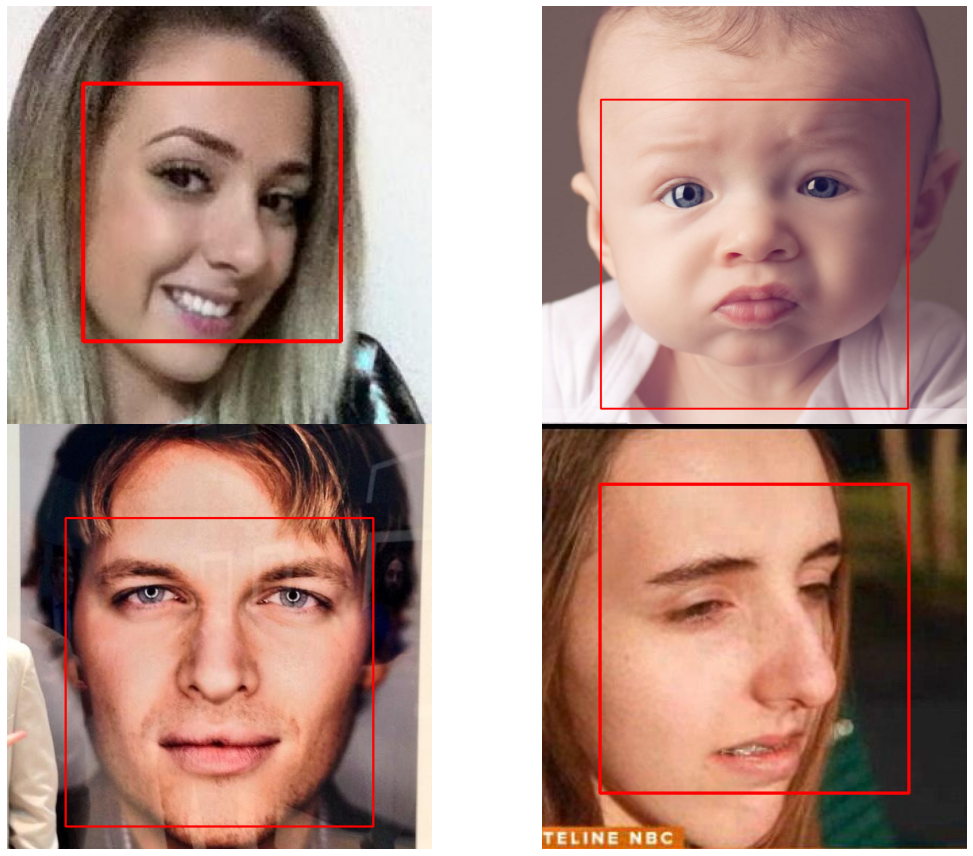

In [ ]:
# Visualize a few training images.
plot(
    image_paths='/content/datasets/train_yolo/images/train', 
    label_paths='/content/datasets/train_yolo/labels/train',
    num_samples=4,
)

**Запишем файл модели yaml на основе встроенной модели детекции yolov8n.yaml**
**Внутри определим 9 классов эмоций (проверим yolo помимо детекции и на классификацию)**

In [ ]:
%%writefile yolo-det.yaml
# Ultralytics YOLO 🚀, GPL-3.0 license

# Parameters
nc: 9  # number of classes
names: 
  0: 'anger'
  1: 'contempt'
  2: 'disgust'
  3: 'fear'
  4: 'happy'
  5: 'neutral'
  6: 'sad'
  7: 'surprise'
  8: 'uncertain'
depth_multiple: 0.33  # scales module repeats
width_multiple: 0.25  # scales convolution channels
path: /content/datasets/train_yolo/images
train: /content/datasets/train_yolo/images/train
val: /content/datasets/train_yolo/images/valid
test: /content/datasets/train_yolo/images/test


# YOLOv8.0n backbone
backbone:
  # [from, repeats, module, args]
  - [-1, 1, Conv, [64, 3, 2]]  # 0-P1/2
  - [-1, 1, Conv, [128, 3, 2]]  # 1-P2/4
  - [-1, 3, C2f, [128, True]]
  - [-1, 1, Conv, [256, 3, 2]]  # 3-P3/8
  - [-1, 6, C2f, [256, True]]
  - [-1, 1, Conv, [512, 3, 2]]  # 5-P4/16
  - [-1, 6, C2f, [512, True]]
  - [-1, 1, Conv, [1024, 3, 2]]  # 7-P5/32
  - [-1, 3, C2f, [1024, True]]
  - [-1, 1, SPPF, [1024, 5]]  # 9

# YOLOv8.0n head
head:
  - [-1, 1, nn.Upsample, [None, 2, 'nearest']]
  - [[-1, 6], 1, Concat, [1]]  # cat backbone P4
  - [-1, 3, C2f, [512]]  # 12

  - [-1, 1, nn.Upsample, [None, 2, 'nearest']]
  - [[-1, 4], 1, Concat, [1]]  # cat backbone P3
  - [-1, 3, C2f, [256]]  # 15 (P3/8-small)

  - [-1, 1, Conv, [256, 3, 2]]
  - [[-1, 12], 1, Concat, [1]]  # cat head P4
  - [-1, 3, C2f, [512]]  # 18 (P4/16-medium)

  - [-1, 1, Conv, [512, 3, 2]]
  - [[-1, 9], 1, Concat, [1]]  # cat head P5
  - [-1, 3, C2f, [1024]]  # 21 (P5/32-large)

  - [[15, 18, 21], 1, Detect, [nc]]  # Detect(P3, P4, P5)


Writing yolo-det.yaml


**Проведем обучение на 15 эпохах и разрешении фото 128х128**

In [ ]:
model = YOLO('/content/yolo-det.yaml') 
model.train(data='/content/yolo-det.yaml', 
            epochs=15, imgsz=128)


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.Conv                  [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.Conv                  [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.C2f                   [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.Conv                  [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.C2f                   [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.Conv                  [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.C2f                   [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.Conv                  [128

  0%|          | 0.00/755k [00:00<?, ?B/s]


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.Conv                  [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.Conv                  [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.C2f                   [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.Conv                  [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.C2f                   [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.Conv                  [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.C2f                   [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.Conv                  [128

  0%|          | 0.00/6.23M [00:00<?, ?B/s]

AMP: checks passed ✅
optimizer: SGD(lr=0.01) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias
train: Scanning /content/datasets/train_yolo/labels/train... 33682 images, 0 backgrounds, 0 corrupt: 100%|██████████| 33682/33682 [00:54<00:00, 617.51it/s] 
train: New cache created: /content/datasets/train_yolo/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
val: Scanning /content/datasets/train_yolo/labels/valid... 9624 images, 0 backgrounds, 0 corrupt: 100%|██████████| 9624/9624 [00:21<00:00, 456.78it/s]
val: New cache created: /content/datasets/train_yolo/labels/valid.cache
Plotting labels to runs/detect/train/labels.jpg... 
Image sizes 128 train, 128 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
 

Сохраним файлы модели после обучения

In [ ]:
directory = pathlib.Path('/content/runs')

with zipfile.ZipFile('/content/drive/MyDrive/train_yolo_mod.zip', mode="w") as archive:
  for file_path in tqdm(directory.rglob("*")):
    archive.write(file_path, arcname=file_path.relative_to(directory))

28it [00:00, 196.92it/s]


Загрузка файлов модели

In [ ]:
# путь к тренировочному файлу
train_zip_file ='/content/drive/MyDrive/train_yolo_mod.zip'
# распаковать файлы
train_files = zipfile.ZipFile(train_zip_file, 'r')
train_files.extractall('/content/runs')

Запустим модель с лучшими обученными весами

In [ ]:
model = YOLO('/content/runs/detect/train/weights/best.pt')

Распакуем тестовый датасет

In [ ]:
# путь к тестовому файлу

test_zip_file = '/content/drive/MyDrive/diplom/test_kaggle.zip'

# распаковать файлы
test_files = zipfile.ZipFile(test_zip_file, 'r')
test_files.extractall()

In [ ]:

# функция для формирования датасета в целях проверки качества модели на kaggle
def TraverFolders(rootDir, model):
  '''
  rootDir - путь к тестовому датасету, по умолчанию /content/test_kaggle
  сохраняет датафрейм в predict_df_sort
  '''
  # count = 0
  img_dict = dict()
  idx = 0
  class_names = {0: 'anger',
                  1: 'contempt',
                  2: 'disgust',
                  3: 'fear',
                  4: 'happy',
                  5: 'neutral',
                  6: 'sad',
                  7: 'surprise',
                  8: 'uncertain'}
  for lists in tqdm(os.listdir(rootDir)):
  
      path = os.path.join(rootDir, lists)
      try:
        results = model(path)
        for result in results:
          boxes = result.boxes
        predictions = int(np.array(boxes.cls.cpu())[0])
      except:
        predictions = random.randint(0,8)

      emotion = class_names[predictions]

      file_name = path[21:]
      file_numer = int(file_name[:-4])
      img_dict[idx] = {'path': path, 'image_path': file_name, 'emotion': emotion, 'fn': file_numer}
      idx+=1

  predict_df = pd.DataFrame(img_dict).T
  predict_df_sort = predict_df.sort_values(by='fn', ignore_index=True)

  predict_df_sort = predict_df_sort[['image_path', 'emotion']]
  return predict_df_sort

In [ ]:
%%capture --no-display
output_predict = TraverFolders(rootDir='/content/test_kaggle', model = model)
output_predict.to_csv('/content/drive/MyDrive/diplom/predict_df_yolo.csv', index=False) 
output_predict.head()

Выходные данные были обрезаны до нескольких последних строк (5000).
image 1/1 /content/test_kaggle/2659.jpg: 128x128 1 neutral, 1 sad, 12.3ms
Speed: 0.2ms preprocess, 12.3ms inference, 2.1ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/1017.jpg: 128x128 1 contempt, 1 happy, 12.1ms
Speed: 0.2ms preprocess, 12.1ms inference, 1.7ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/4535.jpg: 128x128 (no detections), 13.8ms
Speed: 0.3ms preprocess, 13.8ms inference, 0.6ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/1592.jpg: 128x128 1 fear, 1 surprise, 11.8ms
Speed: 0.2ms preprocess, 11.8ms inference, 1.7ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/2637.jpg: 128x128 1 happy, 12.3ms
Speed: 0.2ms preprocess, 12.3ms inference, 1.9ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/2984.jpg: 128x128 1 fear, 1 surprise, 12.5ms
S

,image_path,emotion
0,0.jpg,anger
1,1.jpg,neutral
2,2.jpg,sad
3,3.jpg,anger
4,4.jpg,anger


Время работы модели по логам не больше 15 милисекунд, т.е. достаточно быстро

In [ ]:
output_predict

,image_path,emotion
0,0.jpg,anger
1,1.jpg,neutral
2,2.jpg,sad
3,3.jpg,anger
4,4.jpg,anger
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,anger
4997,4997.jpg,surprise
4998,4998.jpg,sad


Результаты теста на kaggle

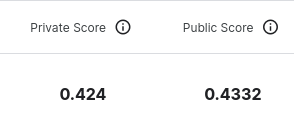

проведем процесс валидации (для картинок)

In [ ]:
metrics = model.val()

Ultralytics YOLOv8.0.55 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)


  0%|          | 0.00/755k [00:00<?, ?B/s]

val: Scanning /content/datasets/train_yolo/labels/valid... 9624 images, 0 backgrounds, 0 corrupt: 100%|██████████| 9624/9624 [00:16<00:00, 574.93it/s] 
val: New cache created: /content/datasets/train_yolo/labels/valid.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 602/602 [02:44<00:00,  3.67it/s]
                   all       9624       9624      0.348      0.601      0.429      0.339
                 anger       9624       1393      0.379      0.745      0.537      0.425
              contempt       9624        577      0.308      0.526      0.312      0.249
               disgust       9624        604      0.303      0.476      0.335      0.266
                  fear       9624        916       0.33      0.714      0.453      0.365
                 happy       9624       1187      0.521      0.832      0.754      0.584
               neutral       9624       1295      0.309      0.673      0.385      0.311
             

In [ ]:
# Plot and visualize images in a 2x2 grid.
def visualize(result_dir, num_samples=4):
    """
    Function accepts a list of images and plots
    them in a 2x2 grid.
    """
    plt.figure(figsize=(20, 12))
    image_names = glob.glob(os.path.join(result_dir, '*.jpg'))
    random.shuffle(image_names)
    for i, image_name in enumerate(image_names):
        image = plt.imread(image_name)
        plt.subplot(2, 2, i+1)
        plt.imshow(image)
        plt.axis('off')
        if i == num_samples-1:
            break
    plt.tight_layout()
    plt.show()


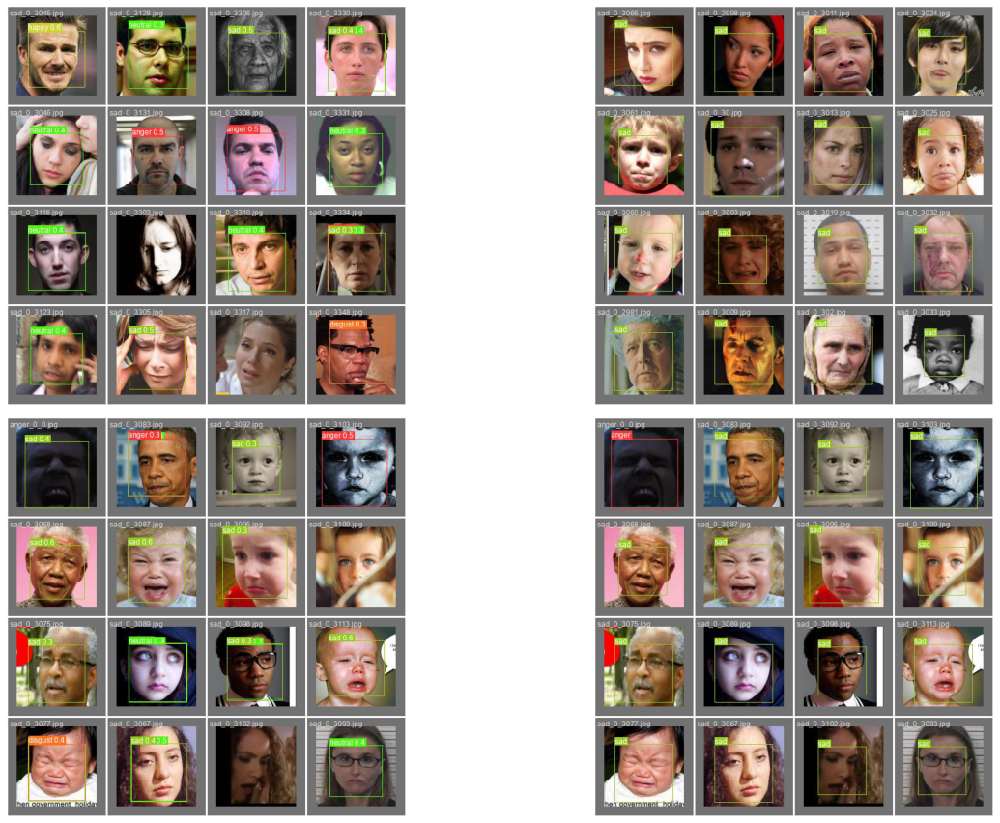

In [ ]:


visualize('/content/runs/detect/val2')



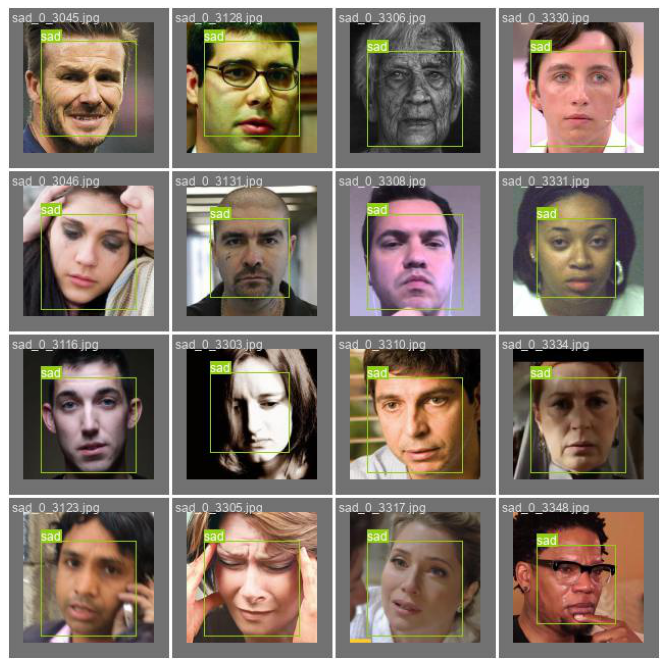

In [ ]:
# обучающая выборка
plt.figure(figsize=(20, 12))
plt.axis('off')
image = plt.imread('/content/runs/detect/val2/val_batch2_labels.jpg')
plt.imshow(image)

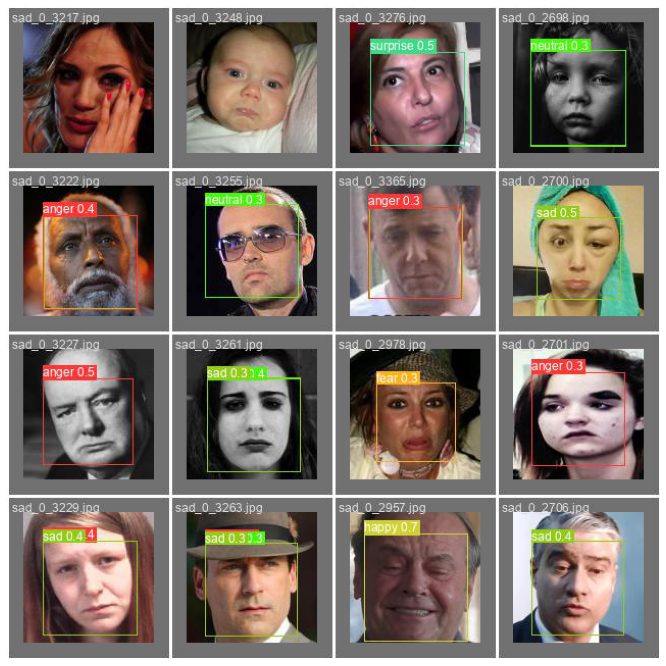

In [ ]:
# результат классификации/детекции
plt.figure(figsize=(20, 12))
plt.axis('off')
image = plt.imread('/content/runs/detect/train/val_batch2_pred.jpg')
plt.imshow(image)

и графики обучения

Populating the interactive namespace from numpy and matplotlib


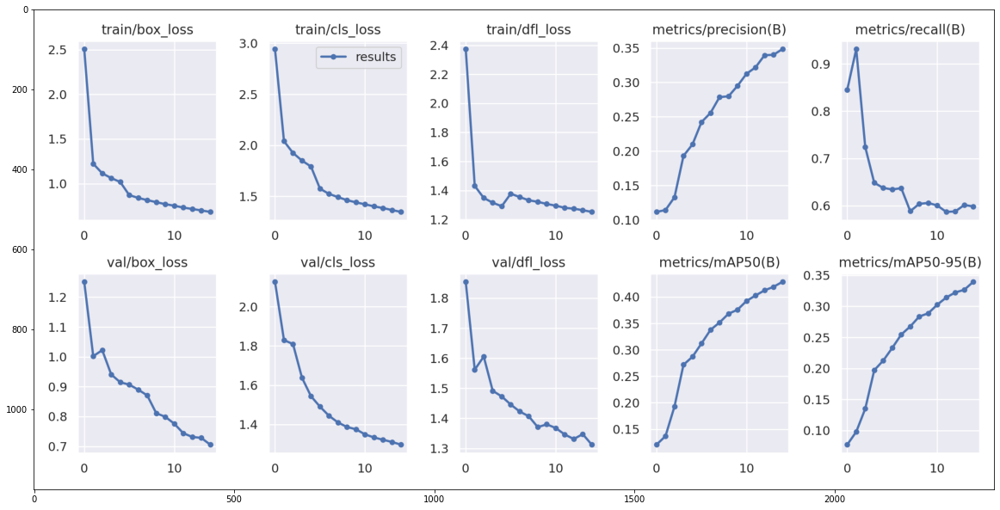

In [ ]:
%matplotlib inline
%pylab inline
plt.figure(figsize=(20, 12))
image = plt.imread('/content/runs/detect/train/results.png')
plt.imshow(image)

**Протестируем модель YOLO на ролике из Ютуба**

In [ ]:
# скопируем заранее сохраненный ролик
!cp /content/drive/MyDrive/diplom/videoplayback_emo.mp4 /content/

Загрузим лучшие веса модели

In [ ]:
model = YOLO('/content/runs/detect/train/weights/best.pt')

Сформируем ролик средствами yolo

In [ ]:
results = model.track(source="/content/videoplayback_emo.mp4", show=True, save=True) 

requirements: YOLOv8 requirement "lap>=0.4" not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 20.1 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for lap: filename=lap-0.4.0-cp39-cp39-linux_x86_64.whl size=1655026 sha256=d93accc18b1cf4b01d5fcfc5ceae5bfb8da98e63b34796a519c4c8e068d2d790
  Stored in directory: /root/.cache/pip/wheels/2f/8b/30/e7dd4f9dc44fb438381df571c9a6bddc35aafd1bf39c4f8911
Successfully built lap

requirements: 1 package updated per ['lap>=0.4']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memo

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/runs/detect/track/videoplayback_emo.mp4"

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

Сохраним ролик

In [ ]:
!cp /content/runs/detect/track/videoplayback_emo.mp4 /content/drive/MyDrive/diplom/

Протестируем на пользовательском ролике

In [ ]:
!cp /content/drive/MyDrive/diplom/video_2023-03-28_21-27-12-2.mp4 /content/

In [ ]:
model = YOLO('/content/runs/detect/train/weights/best.pt')

In [ ]:
results = model.track(source="/content/video_2023-03-28_21-27-12-2.mp4", show=True, save=True) 

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

video 1/1 (1/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 9.3ms
video 1/1 (2/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 9.3ms
video 1/1 (3/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 8.9ms
video 1/1 (4/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 9.4ms
video 1/1 (5/371) /conten

**Напишем функцию воспроизведения видео для исопользования в будущем**

In [ ]:
model_path = '/content/runs/detect/train/weights/best.pt'

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

def detect_video(model_path, video_path):
  model = YOLO(model_path)
  results = model.track(source=video_path, show=True, save=True) 
  # Input video path
  save_path = "/content/runs/detect/track/temp_video.mp4"

  # Compressed video path
  compressed_path = "/content/result_compressed.mp4"

  os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

  # Show video
  mp4 = open(compressed_path,'rb').read()
  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  return HTML("""
  <video width=400 controls>
        <source src="%s" type="video/mp4">
  </video>
  """ % data_url)

In [ ]:
detect_video(model_path= model_path, video_path = '/content/video_2023-03-28_21-27-12-2.mp4')

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

video 1/1 (1/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 13.1ms
video 1/1 (2/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 11.2ms
video 1/1 (3/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 11.0ms
video 1/1 (4/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 10.7ms
video 1/1 (5/371) /co

**Попробуем обучить модель классификации с большим количеством параметров (yolov8x)**

Загрузим прежний датасет

In [ ]:
# путь к тренировочному файлу
train_zip_file = '/content/drive/MyDrive/train_yolo4.zip'
# распаковать файлы
train_files = zipfile.ZipFile(train_zip_file, 'r')
train_files.extractall('/content/datasets/train_yolo')

**Запишем файл модели yaml на основе встроенной модели детекции yolov8x.yaml**
**Внутри определим 9 классов эмоций (обучим yolo на классификацию)**

In [ ]:
%%writefile yolo-det.yaml
# Ultralytics YOLO 🚀, GPL-3.0 license

# Parameters
nc: 9  # number of classes
names: 
  0: 'anger'
  1: 'contempt'
  2: 'disgust'
  3: 'fear'
  4: 'happy'
  5: 'neutral'
  6: 'sad'
  7: 'surprise'
  8: 'uncertain'

path: /content/datasets/train_yolo/images
train: /content/datasets/train_yolo/images/train
val: /content/datasets/train_yolo/images/valid
test: /content/datasets/train_yolo/images/test




Overwriting yolo-det.yaml


In [ ]:
model = YOLO('yolov8x.yaml') # build from YAML and transfer weights


                   from  n    params  module                                       arguments                     
  0                  -1  1      2320  ultralytics.nn.modules.Conv                  [3, 80, 3, 2]                 
  1                  -1  1    115520  ultralytics.nn.modules.Conv                  [80, 160, 3, 2]               
  2                  -1  3    436800  ultralytics.nn.modules.C2f                   [160, 160, 3, True]           
  3                  -1  1    461440  ultralytics.nn.modules.Conv                  [160, 320, 3, 2]              
  4                  -1  6   3281920  ultralytics.nn.modules.C2f                   [320, 320, 6, True]           
  5                  -1  1   1844480  ultralytics.nn.modules.Conv                  [320, 640, 3, 2]              
  6                  -1  6  13117440  ultralytics.nn.modules.C2f                   [640, 640, 6, True]           
  7                  -1  1   3687680  ultralytics.nn.modules.Conv                  [640

**Проведем обучение на 15 эпохах и разрешении фото 128х128**

In [ ]:


# Train the model
model.train(data='/content/yolo-det.yaml', epochs=15, imgsz=128)

Ultralytics YOLOv8.0.55 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8x.yaml, data=/content/yolo-det.yaml, epochs=15, patience=50, batch=16, imgsz=128, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=

  0%|          | 0.00/755k [00:00<?, ?B/s]

Overriding model.yaml nc=80 with nc=9

                   from  n    params  module                                       arguments                     
  0                  -1  1      2320  ultralytics.nn.modules.Conv                  [3, 80, 3, 2]                 
  1                  -1  1    115520  ultralytics.nn.modules.Conv                  [80, 160, 3, 2]               
  2                  -1  3    436800  ultralytics.nn.modules.C2f                   [160, 160, 3, True]           
  3                  -1  1    461440  ultralytics.nn.modules.Conv                  [160, 320, 3, 2]              
  4                  -1  6   3281920  ultralytics.nn.modules.C2f                   [320, 320, 6, True]           
  5                  -1  1   1844480  ultralytics.nn.modules.Conv                  [320, 640, 3, 2]              
  6                  -1  6  13117440  ultralytics.nn.modules.C2f                   [640, 640, 6, True]           
  7                  -1  1   3687680  ultralytics

  0%|          | 0.00/6.23M [00:00<?, ?B/s]

AMP: checks passed ✅
optimizer: SGD(lr=0.01) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias
train: Scanning /content/datasets/train_yolo/labels/train... 33682 images, 0 backgrounds, 0 corrupt: 100%|██████████| 33682/33682 [00:33<00:00, 1009.23it/s]
train: New cache created: /content/datasets/train_yolo/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
val: Scanning /content/datasets/train_yolo/labels/valid... 9624 images, 0 backgrounds, 0 corrupt: 100%|██████████| 9624/9624 [00:15<00:00, 619.73it/s]
val: New cache created: /content/datasets/train_yolo/labels/valid.cache
Plotting labels to runs/detect/train/labels.jpg... 
Image sizes 128 train, 128 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size

Сохраним файлы модели после обучения

In [ ]:

import pathlib
from pathlib import Path
from google.colab.patches import cv2_imshow
import cv2

In [ ]:
directory = pathlib.Path('/content/runs')

with zipfile.ZipFile('/content/drive/MyDrive/diplom/train_yolo_modX.zip', mode="w") as archive:
  for file_path in tqdm(directory.rglob("*")):
    archive.write(file_path, arcname=file_path.relative_to(directory))

28it [00:02, 13.09it/s] 


Загрузка файлов модели

In [ ]:
# путь к тренировочному файлу
train_zip_file ='/content/drive/MyDrive/diplom/train_yolo_modX.zip'
# распаковать файлы
train_files = zipfile.ZipFile(train_zip_file, 'r')
train_files.extractall('/content/runs')

In [ ]:
model = YOLO('/content/runs/detect/train/weights/best.pt')

Распакуем тестовый датасет

In [ ]:
# путь к тестовому файлу

test_zip_file = '/content/drive/MyDrive/diplom/test_kaggle.zip'

# распаковать файлы
test_files = zipfile.ZipFile(test_zip_file, 'r')
test_files.extractall()

In [ ]:

# функция для формирования датасета в целях проверки качества модели на kaggle
def TraverFolders(rootDir, model):
  '''
  rootDir - путь к тестовому датасету, по умолчанию /content/test_kaggle
  сохраняет датафрейм в predict_df_sort
  '''
  # count = 0
  img_dict = dict()
  idx = 0
  class_names = {0: 'anger',
                  1: 'contempt',
                  2: 'disgust',
                  3: 'fear',
                  4: 'happy',
                  5: 'neutral',
                  6: 'sad',
                  7: 'surprise',
                  8: 'uncertain'}
  for lists in tqdm(os.listdir(rootDir)):
      
      
      
      
      path = os.path.join(rootDir, lists)
      try:
        results = model(path)
        for result in results:
          boxes = result.boxes
        predictions = int(np.array(boxes.cls.cpu())[0])
      except:
        predictions = random.randint(0,8)

      emotion = class_names[predictions]

      file_name = path[21:]
      file_numer = int(file_name[:-4])
      img_dict[idx] = {'path': path, 'image_path': file_name, 'emotion': emotion, 'fn': file_numer}
      idx+=1

      # count +=1
      # if count >= 10:
      #   break

  predict_df = pd.DataFrame(img_dict).T
  predict_df_sort = predict_df.sort_values(by='fn', ignore_index=True)
  # predict_df.set_index('fn')
  # predict_df_sort = predict_df.sort_index()
  predict_df_sort = predict_df_sort[['image_path', 'emotion']]
  return predict_df_sort

In [ ]:
%%capture --no-display
output_predict = TraverFolders(rootDir='/content/test_kaggle', model = model)
output_predict.to_csv('/content/drive/MyDrive/diplom/predict_df_yoloX.csv', index=False) 
output_predict.head()

Выходные данные были обрезаны до нескольких последних строк (5000).
image 1/1 /content/test_kaggle/3124.jpg: 128x128 1 neutral, 11.8ms
Speed: 0.2ms preprocess, 11.8ms inference, 2.0ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/707.jpg: 128x128 1 neutral, 12.9ms
Speed: 0.2ms preprocess, 12.9ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/2217.jpg: 128x128 1 neutral, 1 surprise, 11.5ms
Speed: 0.2ms preprocess, 11.5ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/1274.jpg: 128x128 (no detections), 11.4ms
Speed: 0.2ms preprocess, 11.4ms inference, 0.5ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/661.jpg: 128x128 1 anger, 12.1ms
Speed: 0.2ms preprocess, 12.1ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 128)

image 1/1 /content/test_kaggle/667.jpg: 128x128 1 sad, 12.1ms
Speed: 0.2ms preprocess, 12.1ms

,image_path,emotion
0,0.jpg,anger
1,1.jpg,neutral
2,2.jpg,sad
3,3.jpg,anger
4,4.jpg,anger


Время работы модели по логам не больше 15 милисекунд, т.е. достаточно быстро

In [ ]:
output_predict

,image_path,emotion
0,0.jpg,anger
1,1.jpg,neutral
2,2.jpg,sad
3,3.jpg,anger
4,4.jpg,anger
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,anger
4997,4997.jpg,surprise
4998,4998.jpg,sad


Результаты теста на kaggle

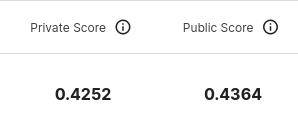

In [ ]:
detect_video(model_path= model_path, video_path = '/content/video_2023-03-28_21-27-12-2.mp4')

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

video 1/1 (1/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 30.0ms
video 1/1 (2/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 22.7ms
video 1/1 (3/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 22.6ms
video 1/1 (4/371) /content/video_2023-03-28_21-27-12-2.mp4: 96x128 (no detections), 23.1ms
video 1/1 (5/371) /co

**Далее попытался обучить модель yolo на детекцию**

Подготовим датасет с одним классом face

In [ ]:
file = open("/content/drive/MyDrive/diplom/pickle_file_yolov8.obj",'rb')
df_temp = pickle.load(file)
file.close()

In [ ]:
df_temp['right'].max()

256

In [ ]:
df_temp['bottom'].max()

256

In [ ]:
df_temp['width'] = 256
df_temp['heigth'] = 256

In [ ]:
df_temp['emotion'] = df_temp['path1'].apply(lambda x: x[15:15+x[15:].find('/')])
df_temp

,path,face_locat,new_img_name,top,right,bottom,left,path1,width,heigth,emotion
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15,/content/train/anger/5828.jpg,256,256,anger
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35,/content/train/anger/1989.jpg,256,256,anger
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46,/content/train/anger/2311.jpg,256,256,anger
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35,/content/train/anger/5156.jpg,256,256,anger
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35,/content/train/anger/1123.jpg,256,256,anger
...,...,...,...,...,...,...,...,...,...,...,...
50042,/content/train_new/contempt/935.jpg,"[(57, 221, 242, 35)]",contempt_0_935.jpg,57,221,242,35,/content/train/contempt/935.jpg,256,256,contempt
50043,/content/train_new/contempt/1695.jpg,"[(64, 201, 219, 46)]",contempt_0_1695.jpg,64,201,219,46,/content/train/contempt/1695.jpg,256,256,contempt
50044,/content/train_new/contempt/462.jpg,"[(64, 201, 219, 46)]",contempt_0_462.jpg,64,201,219,46,/content/train/contempt/462.jpg,256,256,contempt
50045,/content/train_new/contempt/2178.jpg,"[(36, 221, 222, 35)]",contempt_0_2178.jpg,36,221,222,35,/content/train/contempt/2178.jpg,256,256,contempt


In [ ]:
class_names = {'anger': 0,
 'contempt': 1,
 'disgust': 2,
 'fear': 3,
 'happy': 4,
 'neutral': 5,
 'sad': 6,
 'surprise': 7,
 'uncertain': 8}

In [ ]:
df_img1 = df_temp[df_temp['width'] == df_temp['heigth']]
df_img1

,path,face_locat,new_img_name,top,right,bottom,left,path1,width,heigth,emotion
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15,/content/train/anger/5828.jpg,256,256,anger
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35,/content/train/anger/1989.jpg,256,256,anger
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46,/content/train/anger/2311.jpg,256,256,anger
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35,/content/train/anger/5156.jpg,256,256,anger
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35,/content/train/anger/1123.jpg,256,256,anger
...,...,...,...,...,...,...,...,...,...,...,...
50042,/content/train_new/contempt/935.jpg,"[(57, 221, 242, 35)]",contempt_0_935.jpg,57,221,242,35,/content/train/contempt/935.jpg,256,256,contempt
50043,/content/train_new/contempt/1695.jpg,"[(64, 201, 219, 46)]",contempt_0_1695.jpg,64,201,219,46,/content/train/contempt/1695.jpg,256,256,contempt
50044,/content/train_new/contempt/462.jpg,"[(64, 201, 219, 46)]",contempt_0_462.jpg,64,201,219,46,/content/train/contempt/462.jpg,256,256,contempt
50045,/content/train_new/contempt/2178.jpg,"[(36, 221, 222, 35)]",contempt_0_2178.jpg,36,221,222,35,/content/train/contempt/2178.jpg,256,256,contempt


In [ ]:
df_img1['x_cen'] = (df_img1['left'] + (-df_img1['left'] + df_img1['right'])/2)/df_img1['width']
df_img1['y_cen'] = (df_img1['top'] + (-df_img1['top'] + df_img1['bottom'])/2)/df_img1['heigth']
df_img1['h_norm'] = (df_img1['right'] - df_img1['left'])/df_img1['width']
df_img1['w_norm'] = (df_img1['bottom'] - df_img1['top'])/df_img1['heigth']
df_img1['class_code'] = 0 # тут особенность присвоим каждой эмоции ноль df_img1['emotion'].apply(lambda x: class_names[x])
df_img1['double_path'] = df_img1['path1']
df_img1['img_name'] = df_img1['new_img_name'].apply(lambda x: x[0:-4])
df_img1

,path,face_locat,new_img_name,top,right,bottom,left,path1,width,heigth,emotion,x_cen,y_cen,h_norm,w_norm,class_code,double_path,img_name
0,/content/train_new/anger/5828.jpg,"[(57, 201, 242, 15)]",anger_0_5828.jpg,57,201,242,15,/content/train/anger/5828.jpg,256,256,anger,0.421875,0.583984,0.726562,0.722656,0,/content/train/anger/5828.jpg,anger_0_5828
1,/content/train_new/anger/1989.jpg,"[(57, 221, 242, 35)]",anger_0_1989.jpg,57,221,242,35,/content/train/anger/1989.jpg,256,256,anger,0.500000,0.583984,0.726562,0.722656,0,/content/train/anger/1989.jpg,anger_0_1989
2,/content/train_new/anger/2311.jpg,"[(64, 201, 219, 46)]",anger_0_2311.jpg,64,201,219,46,/content/train/anger/2311.jpg,256,256,anger,0.482422,0.552734,0.605469,0.605469,0,/content/train/anger/2311.jpg,anger_0_2311
3,/content/train_new/anger/5156.jpg,"[(36, 221, 222, 35)]",anger_0_5156.jpg,36,221,222,35,/content/train/anger/5156.jpg,256,256,anger,0.500000,0.503906,0.726562,0.726562,0,/content/train/anger/5156.jpg,anger_0_5156
4,/content/train_new/anger/1123.jpg,"[(36, 221, 222, 35)]",anger_0_1123.jpg,36,221,222,35,/content/train/anger/1123.jpg,256,256,anger,0.500000,0.503906,0.726562,0.726562,0,/content/train/anger/1123.jpg,anger_0_1123
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50042,/content/train_new/contempt/935.jpg,"[(57, 221, 242, 35)]",contempt_0_935.jpg,57,221,242,35,/content/train/contempt/935.jpg,256,256,contempt,0.500000,0.583984,0.726562,0.722656,0,/content/train/contempt/935.jpg,contempt_0_935
50043,/content/train_new/contempt/1695.jpg,"[(64, 201, 219, 46)]",contempt_0_1695.jpg,64,201,219,46,/content/train/contempt/1695.jpg,256,256,contempt,0.482422,0.552734,0.605469,0.605469,0,/content/train/contempt/1695.jpg,contempt_0_1695
50044,/content/train_new/contempt/462.jpg,"[(64, 201, 219, 46)]",contempt_0_462.jpg,64,201,219,46,/content/train/contempt/462.jpg,256,256,contempt,0.482422,0.552734,0.605469,0.605469,0,/content/train/contempt/462.jpg,contempt_0_462
50045,/content/train_new/contempt/2178.jpg,"[(36, 221, 222, 35)]",contempt_0_2178.jpg,36,221,222,35,/content/train/contempt/2178.jpg,256,256,contempt,0.500000,0.503906,0.726562,0.726562,0,/content/train/contempt/2178.jpg,contempt_0_2178


Разделим датасет на train/test/valid

In [ ]:
!pip install fast_ml

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.1/42.1 KB 4.7 MB/s eta 0:00:00


In [ ]:
from fast_ml.model_development import train_valid_test_split

In [ ]:
X_train, y_train, X_valid, y_valid, X_test, y_test = train_valid_test_split(df_img1, target = 'path1', random_state = 48,
                                                                            train_size=0.7, valid_size=0.2, test_size=0.1)

In [ ]:
targ_folder = '/content/datasets/train_yolo_det'

In [ ]:
if not os.path.exists(targ_folder + '/images/train'):
 # Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/images/train')  
if not os.path.exists(targ_folder + '/images/test'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/images/test') 
if not os.path.exists(targ_folder + '/images/valid'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/images/valid') 
if not os.path.exists(targ_folder + '/labels/train'):
 # Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/labels/train')  
if not os.path.exists(targ_folder + '/labels/test'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/labels/test') 
if not os.path.exists(targ_folder + '/labels/valid'):
# Каталог не существует, создайте операцию
  os.makedirs(targ_folder + '/labels/valid') 

Фукнция для формирования файлов меток

In [ ]:
def trans_labels(data, targ_path):
  for i_data in tqdm(data.index):
    line = data.loc[i_data]
    lines = [str(line['class_code']), ' ', 
             str(line['x_cen']), ' ', 
             str(line['y_cen']), ' ', 
             str(line['w_norm']), ' ', 
             str(line['h_norm'])]
    name_file = line['img_name']
    with open(targ_path+name_file+'.txt', "w") as file:
      for i_line in lines:
          file.write(i_line)

In [ ]:
trans_labels(X_train, targ_folder+'/labels/train/')
trans_labels(X_test, targ_folder+'/labels/test/')
trans_labels(X_valid, targ_folder+'/labels/valid/')

100%|██████████| 9624/9624 [00:17<00:00, 534.92it/s]


Функция для формирования файлов фото

In [ ]:
import shutil

In [ ]:
def trans_images(data, targ_path):
  for i_data in tqdm(data.index):
    # print(i_data, type(i_data))
    temp_i_data = data.loc[i_data]
    original = temp_i_data['double_path']
    target = targ_path + temp_i_data['new_img_name']
    shutil.copyfile(original, target)

In [ ]:
trans_images(X_train, targ_folder+'/images/train/')
trans_images(X_test, targ_folder+'/images/test/')
trans_images(X_valid, targ_folder+'/images/valid/')

100%|██████████| 9624/9624 [00:45<00:00, 209.28it/s]


In [ ]:
import pathlib
from pathlib import Path

Сохраним датасет в архив

In [ ]:
directory = pathlib.Path('/content/datasets/train_yolo_det')

with zipfile.ZipFile('/content/train_yolo4_det.zip', mode="w") as archive:
  for file_path in tqdm(directory.rglob("*")):
    archive.write(file_path, arcname=file_path.relative_to(directory))

96244it [03:02, 526.54it/s] 


Сохраним архив датасета на гугл диск (на будущее)

In [ ]:
!cp /content/train_yolo4_det.zip /content/drive/MyDrive/

Распакуем датасет в директорию /content/datasets/train_yolo

In [ ]:
# путь к тренировочному файлу
train_zip_file = '/content/drive/MyDrive/train_yolo4_det.zip'
# распаковать файлы
train_files = zipfile.ZipFile(train_zip_file, 'r')
train_files.extractall('/content/datasets/train_yolo')

In [ ]:
# # путь к тренировочному файлу
# train_zip_file = '/content/drive/MyDrive/train_yolo.zip'
# # распаковать файлы
# train_files = zipfile.ZipFile(train_zip_file, 'r')
# train_files.extractall('/content/train_yolo')

Посмотрим, что получилось с датасетом для обучения YOLO

In [ ]:
# !pip install face_recognition
# import face_recognition
# import cv2
import zipfile
import requests
import cv2
import matplotlib.pyplot as plt
import glob 
import random
import os

#------------------------
from tqdm import tqdm
from PIL import Image, ImageDraw

In [ ]:


# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # Denormalize the coordinates.
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)

        thickness = max(2, int(w/275))
                
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=(0, 0, 255),
            thickness=thickness
        )
    return image

In [ ]:
%matplotlib inline
%pylab inline
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
  all_images = []
  all_images.extend(glob.glob(image_paths+'/*.jpg'))
  all_images.extend(glob.glob(image_paths+'/*.JPG'))
  
  all_images.sort()
  # print(all_images)
  num_images = len(all_images)
  
  plt.figure(figsize=(15, 12))
  for i in range(num_samples):
      # print(num_images)
      j = random.randint(0,num_images-1)
      image_name = all_images[j]
      image_name = '.'.join(image_name.split(os.path.sep)[-1].split('.')[:-1])
      image = cv2.imread(all_images[j])
      # print(image)
      with open(os.path.join(label_paths, image_name+'.txt'), 'r') as f:
        bboxes = []
        labels = []
        label_lines = f.readlines()
        for label_line in label_lines:
          label = label_line[0]
          bbox_string = label_line[2:]
          x_c, y_c, w, h = bbox_string.split(' ')
          x_c = float(x_c)
          y_c = float(y_c)
          w = float(w)
          h = float(h)
          bboxes.append([x_c, y_c, w, h])
          labels.append(label)
      result_image = plot_box(image, bboxes, labels)
      plt.subplot(2, 2, i+1)
      plt.imshow(result_image[:, :, ::-1])
      plt.axis('off')
  plt.subplots_adjust(wspace=1)
  plt.tight_layout()
  # print(result_image)
  plt.show()

Populating the interactive namespace from numpy and matplotlib


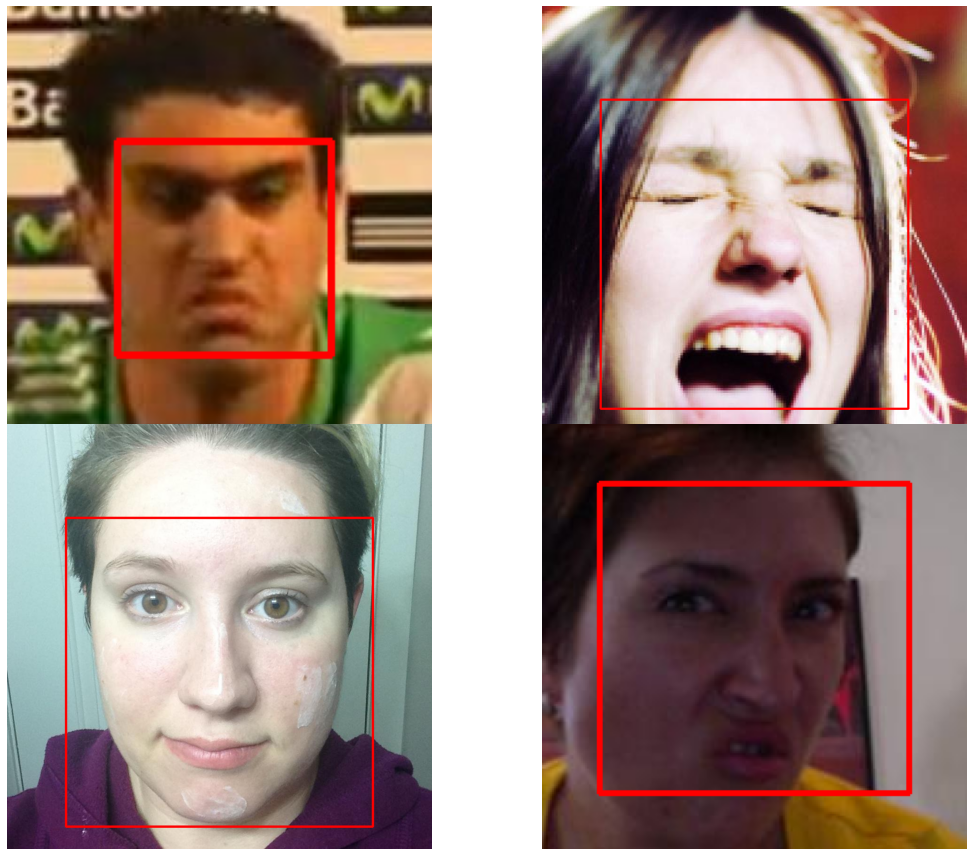

In [ ]:
# Visualize a few training images.
plot(
    image_paths='/content/datasets/train_yolo/images/train', 
    label_paths='/content/datasets/train_yolo/labels/train',
    num_samples=4,
)

**Запишем файл модели yaml на основе встроенной модели детекции yolov8n.yaml.**

**Обучим yolo на детекцию**

In [ ]:
%%writefile yolo-det1.yaml
# Ultralytics YOLO 🚀, GPL-3.0 license
path: /content/datasets/train_yolo/images
train: /content/datasets/train_yolo/images/train
val: /content/datasets/train_yolo/images/valid
test: /content/datasets/train_yolo/images/test

# class names
names: 
  0: 'face'

Writing yolo-det1.yaml


**Проведем обучение на 20 эпохах и разрешении фото 128х128**

In [ ]:
model = YOLO('yolov8x.yaml') # build from YAML and transfer weights

# Train the model
model.train(data='/content/yolo-det1.yaml', epochs=20, imgsz=256, batch = 32, dropout = 0.2)


                   from  n    params  module                                       arguments                     
  0                  -1  1      2320  ultralytics.nn.modules.Conv                  [3, 80, 3, 2]                 
  1                  -1  1    115520  ultralytics.nn.modules.Conv                  [80, 160, 3, 2]               
  2                  -1  3    436800  ultralytics.nn.modules.C2f                   [160, 160, 3, True]           
  3                  -1  1    461440  ultralytics.nn.modules.Conv                  [160, 320, 3, 2]              
  4                  -1  6   3281920  ultralytics.nn.modules.C2f                   [320, 320, 6, True]           
  5                  -1  1   1844480  ultralytics.nn.modules.Conv                  [320, 640, 3, 2]              
  6                  -1  6  13117440  ultralytics.nn.modules.C2f                   [640, 640, 6, True]           
  7                  -1  1   3687680  ultralytics.nn.modules.Conv                  [640

KeyboardInterrupt: ignored

**Обучение весьма долгое, тем более я нашел уже обученную модель yolo на детекцию лиц, которую в дальнейшем использовал**

Работа с ней в другом ноутбуке.